# Tutorial on Rotation Analysis with GEMDAT

Welcome to this tutorial on rotation analysis using the **GEMDAT** Python library for Molecular Dynamics (MD) simulations. GEMDAT is a powerful tool built on top of [Pymatgen](https://pymatgen.org/), which makes it straightforward to integrate into your existing Pymatgen-based workflows for materials analysis.

In this workshop, we'll introduce the basics of diffusion analysis with Gemdat. You'll learn how to:

- Perform orientational analysis using GEMDAT
- Evaluate rotational diffusivity using GEMDAT
- Interpret and visualize the results

##### 1. Orientational Analysis on $Na_3(Sb/W)S_4$


In [1]:
# This block will suppress all warnings
import os
import warnings
warnings.filterwarnings("ignore")

In [2]:
# Import the Trajectory class from gemdat
from gemdat import Trajectory

# Define the path to workshop folder
os.chdir('path/to/workshop/folder')

# Define the path to VASP data
VASPRUN = r'data/vasprun.xml'

# Read and cache the trajectory data
trajectory = Trajectory.from_vasprun(VASPRUN, cache=r'data/vasprun.xml.a45e320a.cache')

If we look again at the MSD per element, note that, apart from sodium, the remaining elements are plateauing very quickly <1ps at MSDs <<1 $Å^2$
This is typical behavior for atoms in a solid. The fact that the MSD is not 0 even though the atoms are not (long-range) diffusing has to do with vibrations about their equillibrium sites. The value at which the MSDs plateau are related to the amplitude of said vibrations (and are e.g. directly related to the Debye-Waller/Temperature factors observable in diffraction)
In the case of $Na_3(Sb/W)S_4$ we see that the vibrational amplitude of sulfur is about double that of Sb and W.

In [3]:
fig = trajectory.plot_msd_per_element()
fig.show()

Since $SbS_4^{3-}$ and $WS_4^{2-}$ are covalently bonded tetrahedral molecules (molecular anions) some of these vibrations correspond to the normal modes of the tetrahedron, i.e. stretching, scissoring etc. as well as librations (small scale rotations) of the tetrahedra about their equillibrium configuration/orientation
The `Orientations` package of gemdat is geared towards analysing the orientations of bonds and molecules.
the `Orientations` class  contains the trajectories of bonds of a given type and can be generated from a `Trajectory` object, given a central atom and a satellite atom.
e.g. for Sb-S bonds we can create the following `Orientations` object

In [4]:
from gemdat import Orientations

oris_Sb_S = Orientations(
    trajectory,
    center_type='Sb',
    satellite_type='S',
)


We can plot the bond-length distribution of the Sb-S bonds along with a (skewed) Gaussian fit. The distribution peaks at ~2.4 Å which is the equilibrium length of an Sb-S bond. The width of the distribution is related to the amplitude of stretching vibrations, i.e.the stiffness of the bond.

In [5]:
fig = oris_Sb_S.plot_bond_length_distribution(bins=100)
fig.show()

We can then quickly visualize the orientations of these Sb-S bonds in spherical coordinates with `orientations.plot_rectilinear()` and/or `orientations.plot_polar()` 

These methods produce and plot an effective orientational probability density function P(Ω) with Ω(φ,θ) the polar angular coordinates of the bond. This has the meaning of the likelyhood of finding a bond in a specific orientation in the crystal.

`orientations.plot_rectilinear()` projects the orientational probability density function on a rectilinear grid, i.e. an x-y rectangular plot with the (φ,Θ) polar angles as coordinates. This is analogous to the usual projections of maps of the earth (spherical) on rectangular planes.

In [6]:
fig = oris_Sb_S.plot_rectilinear(normalize_histo=True)
fig.show()

`orientations.plot_polar()` projects the exact same orientational probability density on a spherical plot, where the radial distance denotes the elevation angle (θ) and the rotation angle denotes the azimuthal angle (φ). Two plots are produced, representing the "upper" and "lower" hemisphere (θ<90° and θ>90°, respectively)

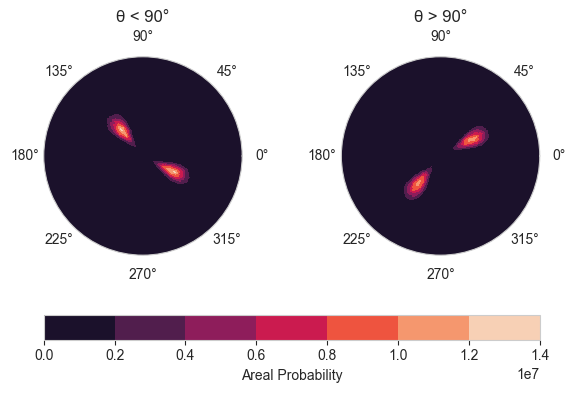

In [7]:
fig = oris_Sb_S.plot_polar(normalize_histo=True)
fig.show()

In the case of Sb-S bonds, we observe that the value is 0 everywhere except for four "hotspots" of probability. These hotspots are separated by (aproximately) the tetrahedral angle (109.4 degrees) and indicate that the tetrahedra in this structure remain ordered in their equilibrium orientations. The diffuse intensity in a small radius about the equillibrium orientations indicate some librational freedom of the bonds.

and similarly for W-S bonds, we see that the W-S bond is slightly shorter than the Sb-S bond, but WS4 tetrahedra assume the same orientations as SbS4 in the lattice.

In [8]:
from gemdat import Orientations

oris_W_S = Orientations(
    trajectory,
    center_type='W',
    satellite_type='S',
)

fig = oris_W_S.plot_bond_length_distribution(bins=100)
fig.show()

In [9]:
fig = oris_W_S.plot_rectilinear(normalize_histo=True)
fig.show()

A useful descriptor to inspect and analyse the rotational motion of bonds is the vector self-correlation (autocorrelation) function, ζ. This is defined as the dot product of a bond vector at time t with the same vector at time t+Δt; with the value averaged over all bonds and all equivalent Δt intervals. $$ ζ (Δt) = <r_i(t) ⋅ r_i(t+Δt)>$$

Intuitively, if the vector is not reorienting the value should be ~1 - the vectors remain parallel to their original direction.
We can calculate and plot the autocorrelation of vectors in the `Orientations` object using the method `Orientations.plot_autocorrelation()`
In the example of Sb-S bonds we see the autocorrelation starts at 1 for Δt=0, it quickly relaxes to a value close to unity and plateaus there. This is indicative of no significant reorientation of the vector. Small librations of the vector, at timescales <1ps is what causes the relaxation to ~0.985. That is also related to the behavior of the MSD at small Δt. The magnitude of the deviation from unity is related to the amplitude of the librations (also captured in the width of the spots in the rectilinear plot). The relaxation time to the equilibrium value is related to the timescale of said librations, of the order of phonon frequencies (i.e. <1ps)

In [10]:
fig = oris_Sb_S.plot_autocorrelation(show_traces=False)
fig.show()

The rotational analysis on the $Na_3SbS_4$ simulation indicates no reorientational motion (i.e. rotational diffusion) of the $SbS_4$ tetrahedra. $Na_3SbS_4$ is a typical ionic-molecular solid, in which the $SbS_4^{3-}$ molecular anions constitute a solid-like rigid framework through which $Na^+$ cations can diffuse.

##### 2. Orientational Analysis on $Li_2SO_4$

Now let us turn our attention to another ionic-molecular crystal where rotational diffusion is more pronounced. The high-temperature phase of lithium sulfate ($α-Li_2SO_4$) is an archetypical example of a so-called plastic crystal, where significant reorientations of the $SO_4^{2-}$ molecular anion take place.

Firstly, let us import MD trajectories of a simulation on the high-temperature phase of $Li_2SO_4$. In this case, this is a LAMMPS simulation of classical MD based on empirical potentials, so we use the `Trajectory.from_lammps()` method to import. The LAMMPS parser requires certain additional input compared to the VASP one, since the temperature, time step and atomic types are not typically written for LAMMPS output.

In [11]:
trajectory = Trajectory.from_lammps(
    coords_file=r'data\trajectory_1000K_5fs.xyz',
    data_file=r'data\in.data',
    temperature=1000,
    time_step=0.005,
    type_mapping={'1':'Li', '2':'S', '3':'O'},
    coords_format= 'xyz',
    atom_style='full',
)

Inspecting the MSD per element, we observe the Li MSD linearly increasing with time, indicating long-range Li-diffusion, the phase is a lithium-ion conductor.
Zooming in at low MSD values, we observe that the S and O MSDs quickly plateau to equillibrium values, similar to the $Na_3SbS_4$ case.
However, there one key difference, the oxygen MSD plateaus at a significantly higher value ~5 $Å^2$ at a timescale of multiple ps. This larger amplitude and slower relaxation indicates this is not vibrational relaxation, but rather bounded diffusion. Oxygen atoms appear to be able to perform displacements of a few angstrom but their diffusion is bounded, they can only diffuse within a limited volume.

In [12]:
fig = trajectory.plot_msd_per_element()
fig.show()

We can extract the orientations of the first-order S-O neighbors (i.e. S-O bonds) using the `Orientations` constructor...

In [13]:
oris = Orientations(
    trajectory,
    center_type='S',
    satellite_type='O',
)

vectors = oris.vectors
vectors.shape

(5001, 128, 3)

...and plot the extracted S-O length distribution; confirming that we are capturing the correct S-O bonds.

In [14]:
fig = oris.plot_bond_length_distribution(bins=100)
fig.show()

Note that the orientation probability distribution function is much more diffuse now. Some structure is apparent but the orientations are much less localized than the $Na_3SbS_4$ case. There is some measurable occupation (non-zero probability) nearly everychere on the sphere. The orientations of the bonds can assume nearly any value. Still there is some structure in the orientational probability function - not all orientations are represented with the same probability.

In [15]:
fig = oris.plot_rectilinear(normalize_histo=True)
fig.show()

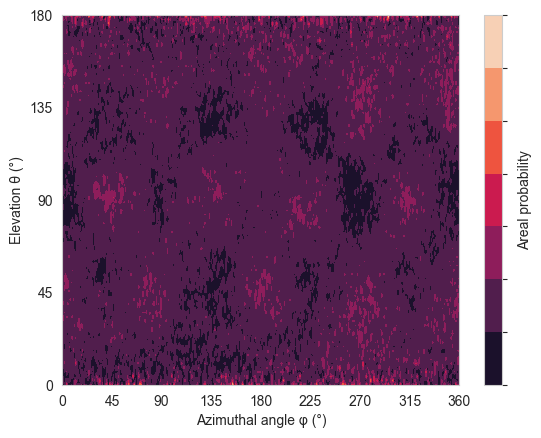

In [16]:
fig = oris.plot_rectilinear(backend='matplotlib')
fig.show()

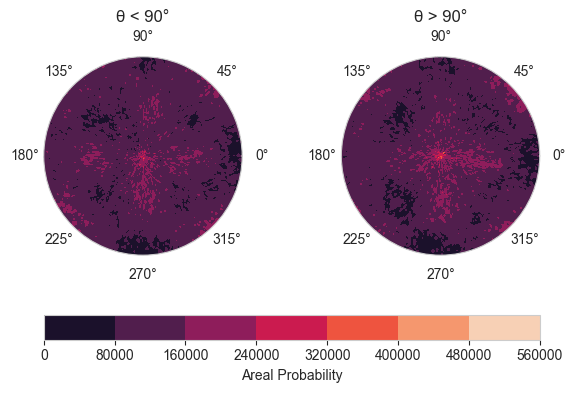

In [17]:
fig = oris.plot_polar(normalize_histo=True)
fig.show()

What is already apparent from the above is the symmetry of the point group on which the $SO_4$ tetrahedron is located, that is $O_h$ (i.e. $m\overset{-}{3}m$). For example, the 4-fold rotational symmetry about θ=0, i.e. the origin of the polar plots; and the mirror at θ=90.

 We can take advantage of this crystalline symmetry to better visualize the orientational distrubtion function using the `symmetrize()` method of the `Orientations` class. This applies the symmetry operations of the point group symmetry to the raw orientational distrubution function (in this case $m\overset{-}{3}m$) to effectively increase the statistics (by x48 in this case).

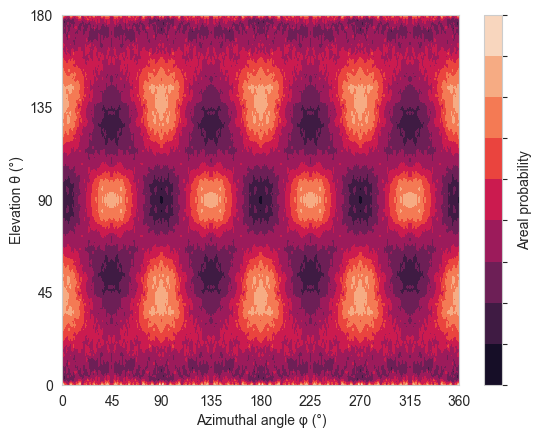

In [18]:
fig = oris.symmetrize(sym_group='m-3m').plot_rectilinear(normalize_histo=True, backend='matplotlib')
fig.show()

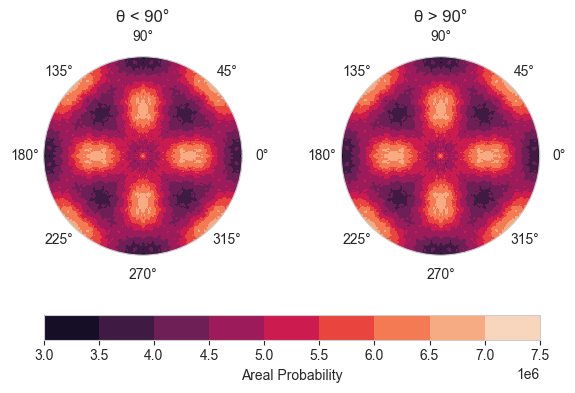

In [19]:
fig = oris.symmetrize(sym_group='m-3m').plot_polar(normalize_histo=True)
fig.show()

The structure of the orientational distrubtion function becomes more apparent, with the probability forming twelve hotspots that are each much more diffuse compared to the $Na_3SbS_4$ case. This is indicative of orientational disorder in the $Li_2SO_4$ crystal, i.e. the $SO_4$ tetrahedron can assume more than one orientation in the crystal. The diffuse nature of the peaks also denotes an increased librational/vibrational amplitude for the $SO_4^{2-}$ molecules.

Orientational disorder can be static or dynamic. By static we mean that each tetrahedron is "locked" at one orientation, in which case we refer to the phase as an orientational glass, or a glassy crystal. Dynamic orientational disorder would imply that the orientations themselves are diffusing, the tetrahedra are reorienting with time, in which case we refer to the phase as a plastic crystal or rotor phase. Both cases would be consistent with the above orientational probability function, so let us investigate whether the orientational disorder is static or dynamic.

In our case of α-Li2SO4 we already have a clue from the MSDs that the orientational disorder is dynamic; since the oxygen MSD plateaus at ~5 $Å^2$ . We can confirm that by inspecting the autocorrelation between the orientations of S-O bonds.

In [20]:
fig = oris.plot_autocorrelation()
fig.show()

In this case we observe the autocorrelation function decaying to ~0 in the picosecond timescale. This is indicative of rotational diffusion of S-O bonds (i.e. rotational diffusion of the $SO_4^{2-}$ molecular anion).

We can quantify the diffusion rate by fitting the decay of the autocorrelation function. To do this, we first extract the autocorrelation data using the `Orientations.autocorrelation()` method. The following code snippet fits the autocorellation data to an exponential decay as $$ ζ=e^{-Δt/τ_c}$$
where $τ_c$ is a characteristic time for the rotational diffusion

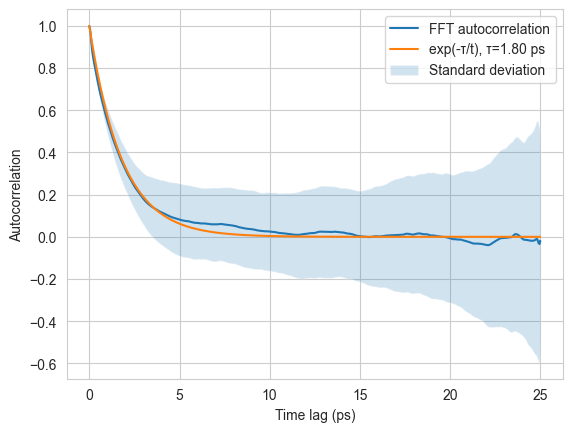

In [21]:
import numpy as np
ac = oris.autocorrelation()
ac_mean = ac.mean(axis=0)
ac_std = ac.std(axis=0)

time_ps = oris._time_step * 1e12
tgrid = np.arange(ac_mean.shape[0]) * time_ps
import matplotlib.pyplot as plt
fig, ax = plt.subplots()

ax.plot(tgrid, ac_mean, label='FFT autocorrelation')

ax.set_xlabel('Time lag (ps)')
ax.set_ylabel('Autocorrelation')

#alternative view in log-scale
#plt.yscale('log')

def exp_decay(t, tau):
    return np.exp(-t/tau)

from scipy.optimize import curve_fit
p0=[1.8] #initial guess for tau in ps

params, covariance = curve_fit(exp_decay, tgrid, ac_mean, p0=p0)
y_fit = exp_decay(tgrid,*params)
ax.plot(tgrid, y_fit, label=f'exp(-τ/t), τ={params[0]:.2f} ps')

ax.fill_between(
    tgrid,
    ac_mean - ac_std,
    ac_mean + ac_std,
    alpha=0.2,
    label='Standard deviation',
)

ax.legend()
plt.show()


Through the fit we derive a characteristic time of $τ_c$=1.80 ps that is a descriptor for the rate of rotational diffusivity in the system.

##### 3. Exercise for you
Determine the temperature dependence of the Li-translational- and SO4-rotational diffusion in $Li_2SO_4$ using the MD datasets provided.